# Self-Driving Car Engineer Nanodegree


### Advanced Lane Finding Project By Abdelkoddous Khamsi

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import math

%matplotlib qt

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')
N = len(images)

print(images)
print(type(images))
print("Number of images ==>", N)

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(1000)
    else:
        print("No corners found in ", fname)

cv2.destroyAllWindows()

['camera_cal\\calibration1.jpg', 'camera_cal\\calibration10.jpg', 'camera_cal\\calibration11.jpg', 'camera_cal\\calibration12.jpg', 'camera_cal\\calibration13.jpg', 'camera_cal\\calibration14.jpg', 'camera_cal\\calibration15.jpg', 'camera_cal\\calibration16.jpg', 'camera_cal\\calibration17.jpg', 'camera_cal\\calibration18.jpg', 'camera_cal\\calibration19.jpg', 'camera_cal\\calibration2.jpg', 'camera_cal\\calibration20.jpg', 'camera_cal\\calibration3.jpg', 'camera_cal\\calibration4.jpg', 'camera_cal\\calibration5.jpg', 'camera_cal\\calibration6.jpg', 'camera_cal\\calibration7.jpg', 'camera_cal\\calibration8.jpg', 'camera_cal\\calibration9.jpg']
<class 'list'>
Number of images ==> 20
No corners found in  camera_cal\calibration1.jpg
No corners found in  camera_cal\calibration4.jpg
No corners found in  camera_cal\calibration5.jpg


objpoints array len 17
imgpoints array len 17


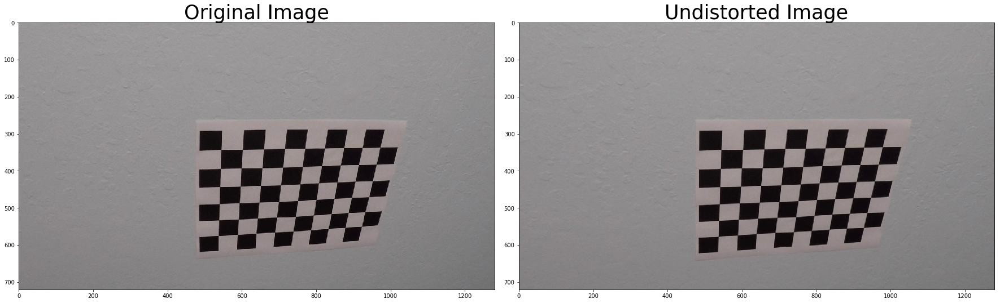

In [2]:
## Camera calibration given
%matplotlib inline

def cal_undistort(img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    cam_calib = cv2.calibrateCamera(objpoints, imgpoints, img.shape[:-1], None, None)
    undist = cv2.undistort(img, cam_calib[1], cam_calib[2])
    return undist

def PlotComparisonView(image_before, image_after, performedProcessing, colormap = (None, None)):
    """
    To avoid repeting ploting commands every time, will be useful throughout
    this notebook 
    """

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image_before, cmap = colormap[0])
    ax1.set_title('Original Image', fontsize=35)
    ax2.imshow(image_after, cmap = colormap[1])
    ax2.set_title(performedProcessing + ' Image', fontsize=35)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

img = cv2.imread(images[1])

print("objpoints array len", len( objpoints))
print("imgpoints array len", len( imgpoints))

undistorted_img = cal_undistort(img, objpoints, imgpoints)

PlotComparisonView(img, undistorted_img, 'Undistorted')

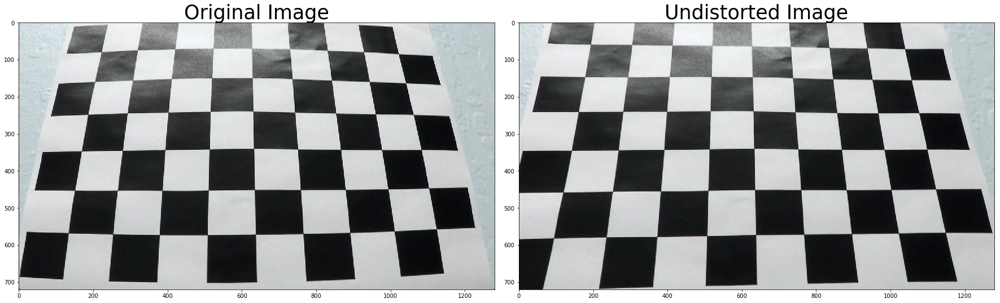

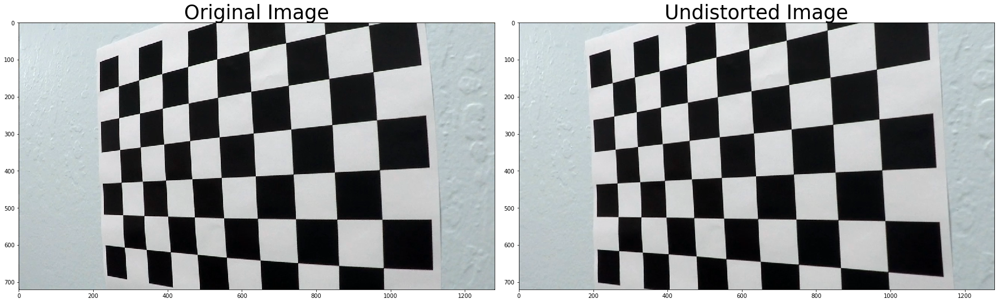

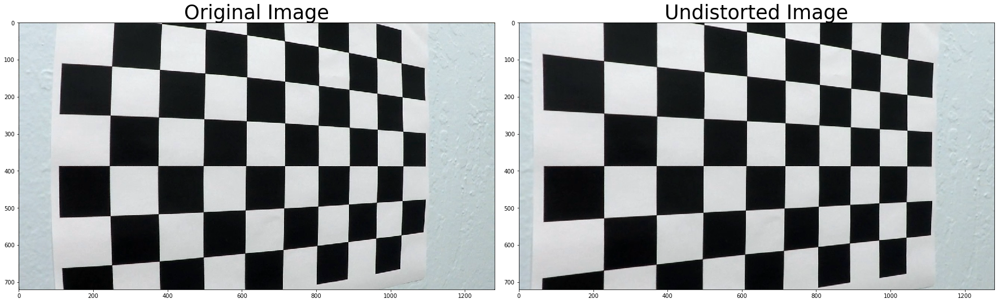

In [3]:
# Visualizing before and after of Undistortion on some chessboard images
for i in range(13,16):
    
    img = cv2.imread(images[i])
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    
    PlotComparisonView(img, undistorted_img, 'Undistorted')

## Then, I'll Apply a distortion correction to raw images

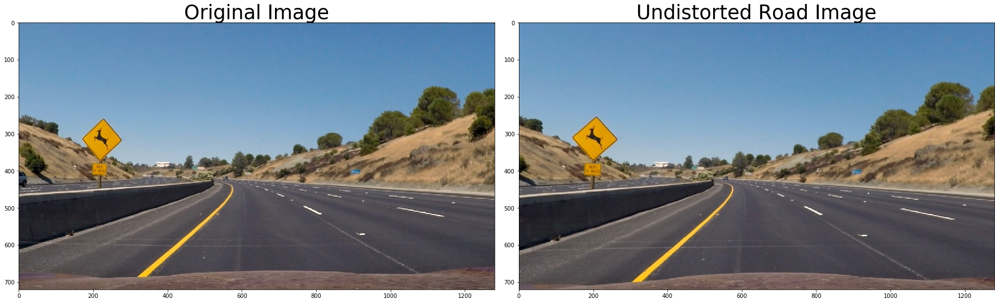

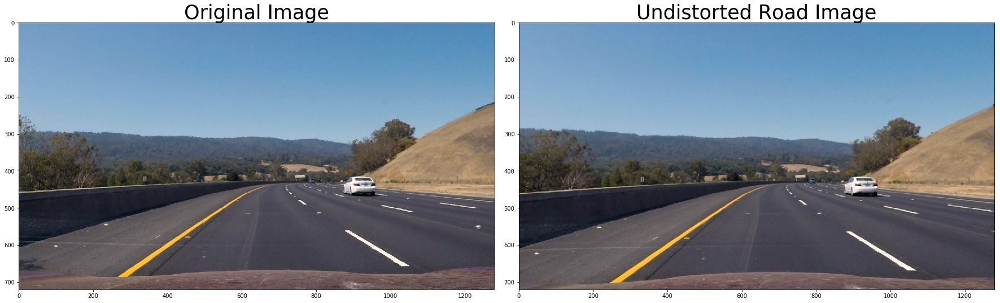

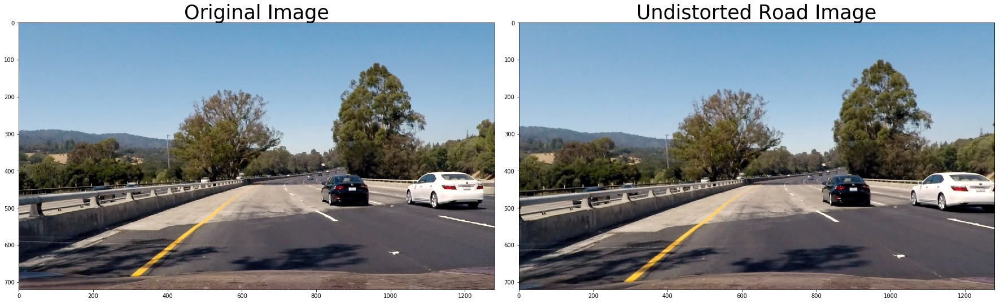

In [4]:
import matplotlib.image as mpimg

# Visualizing before and after of Undistortion on real world application image
test_images = glob.glob('test_images/test*.jpg')

for i in range(1,4):
    img = mpimg.imread(test_images[i])
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    PlotComparisonView(img, undistorted_img, 'Undistorted Road')

## I'll Use color transforms, gradients, etc., to create a thresholded binary image

* Let's start playing with the sobel operator

In [5]:
def axis_gradient(img, ksize=9, thresh=(30,255)):
    ## x gradient

    # convert to gray scale
    #if channel == 'gray':
    #    gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #else:
    #    gray_image = img
    if len(img.shape) == 3:
        gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    elif len(img.shape) ==2:
        gray_image = img
    
    height = img.shape[0]
    width = img.shape[1]
    # derivative along x
    sobelx = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize)

    abs_sobel = np.absolute(sobelx)

    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))

    single_axis_binary = np.zeros_like(gray_image, dtype=np.uint8)
    #single_axis_binary = np.zeros((height,width,1), np.uint8)

    single_axis_binary[ (scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return single_axis_binary#cv2.Canny(gray_image, 20, 50) #

def magnitude_gradient(img, ksize=9, thresh=(50,255),channel='gray'):
    ## mag gradient
    # convert to gray scale
    #if channel == 'gray':
    #    gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #else:
    #    gray_image = img
    if len(img.shape) == 3:
        gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    elif len(img.shape) ==2:
        gray_image = img
        
    # derivative along x and y
    sobelx = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize)
    sobely = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize)
    sobelxy = np.sqrt(sobelx**2 + sobely**2)

    scaled_sobel = np.uint8(255*sobelxy/np.max(sobelxy))

    mag_binary = np.zeros_like(gray_image)
    mag_binary[ (scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return mag_binary

def direction_gradient(img, ksize=9, thresh=(0.7,1.3),channel='gray'):
    ## direction gradient

    # convert to gray scale
    #if channel == 'gray':
    #    gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #else:
    #    gray_image = img
    if len(img.shape) == 3:
        gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    elif len(img.shape) ==2:
        gray_image = img
        
    # derivative along x and y
    sobelx = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize)
    sobely = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize)
    
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)

    sobel_direction = np.arctan2(abs_sobely, abs_sobelx)

    dir_binary = np.zeros_like(sobel_direction)
    dir_binary[ (sobel_direction >= thresh[0]) & (sobel_direction <= thresh[1])] = 1

    return dir_binary


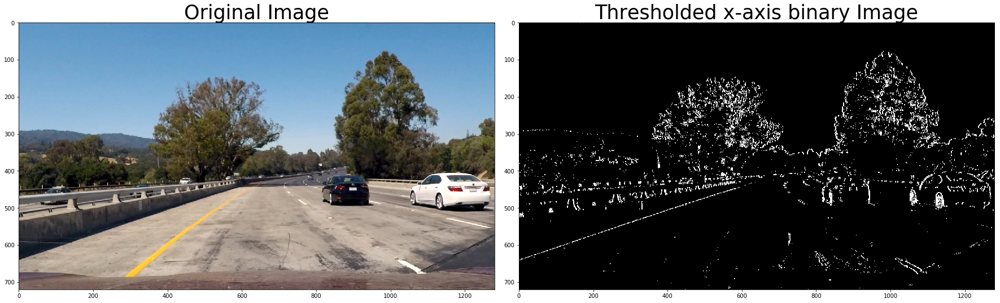

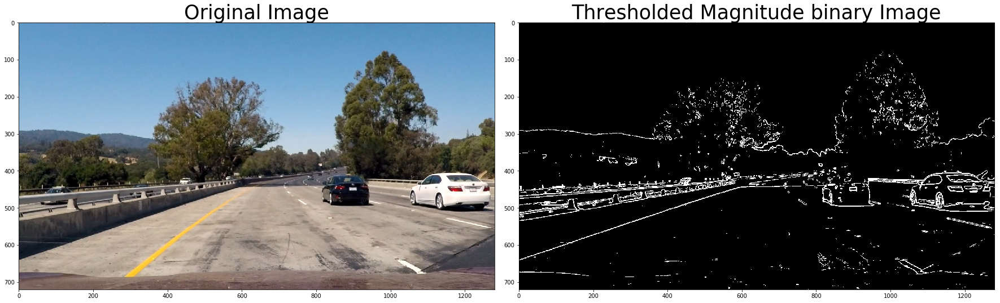

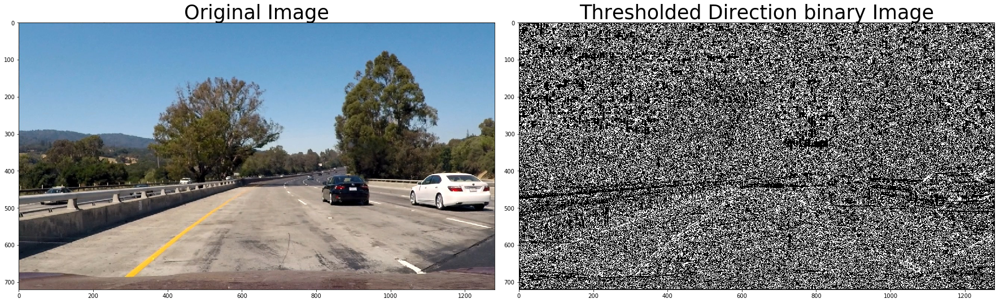

In [6]:
image = mpimg.imread(test_images[0])

# Apply all three distinct gradient
axis_binary_output = axis_gradient(image)
mag_binary_output = magnitude_gradient(image)
dir_binary_output = direction_gradient(image)


PlotComparisonView(image, axis_binary_output, 'Thresholded x-axis binary', (None, 'gray'))
PlotComparisonView(image, mag_binary_output, 'Thresholded Magnitude binary', (None, 'gray'))
PlotComparisonView(image, dir_binary_output, 'Thresholded Direction binary', (None, 'gray'))

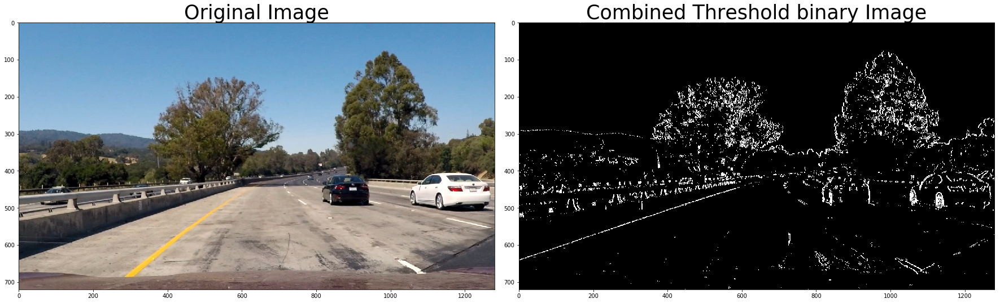

In [7]:
# Play with threshold combination
combined_binary = np.zeros_like(axis_binary_output)
combined_binary[ (axis_binary_output==1) | (mag_binary_output*dir_binary_output == 1) ] = 1

PlotComparisonView(image, combined_binary, 'Combined Threshold binary', (None, 'gray'))


In [8]:
def combinedGradient_thresholdedBinary(img):
    
    #print("Image shape ==>",img.shape)
    axis_binary_output = axis_gradient(img)
    mag_binary_output = magnitude_gradient(img)
    dir_binary_output = direction_gradient(img)
    
    combined_binary = np.zeros_like(axis_binary_output)
    combined_binary[ (axis_binary_output==1) | (mag_binary_output*dir_binary_output == 1) ] = 1

    return combined_binary

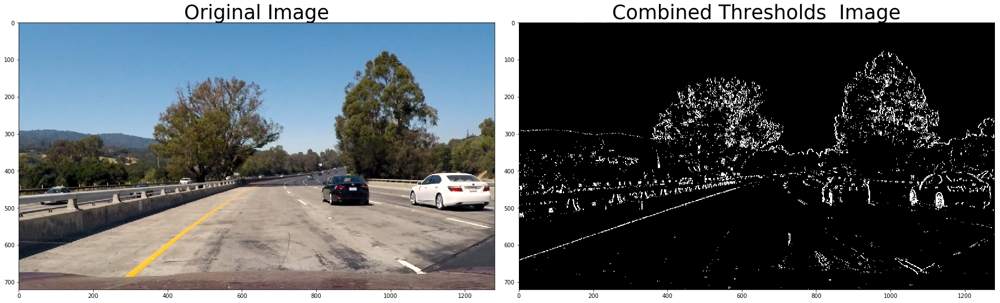

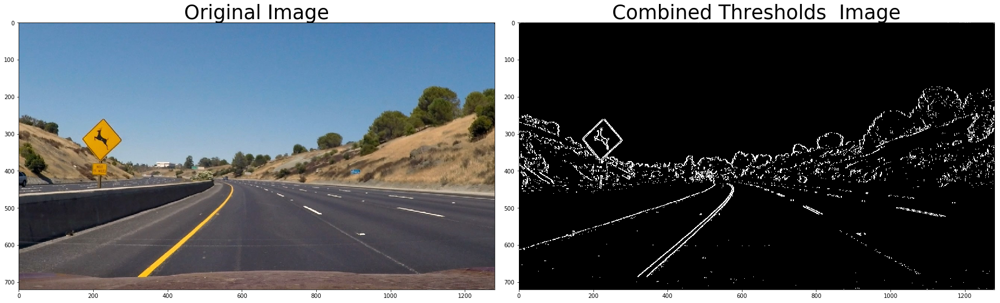

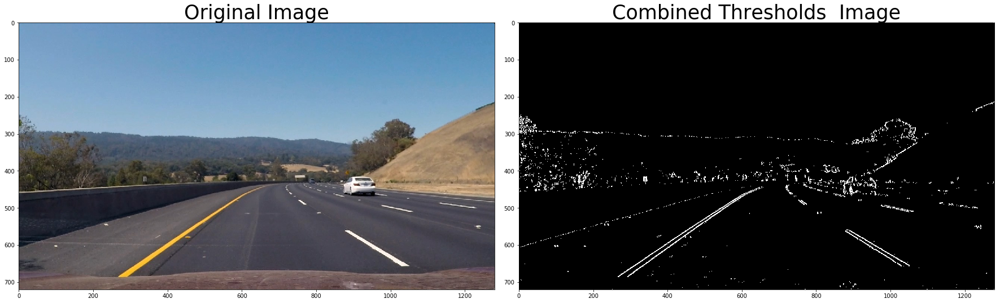

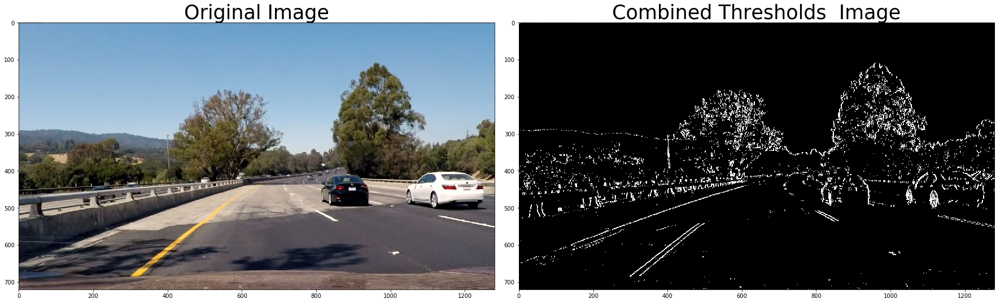

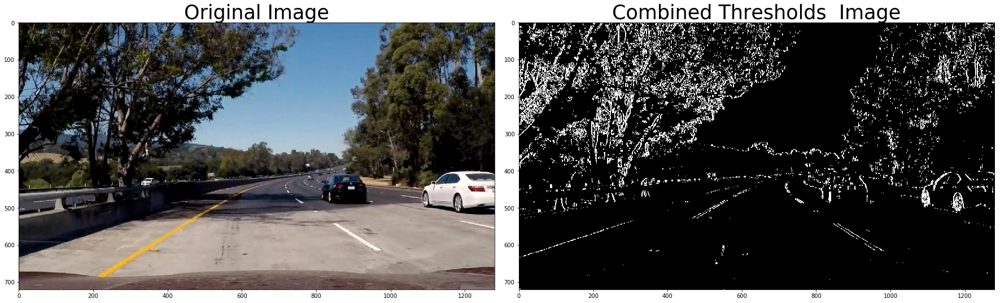

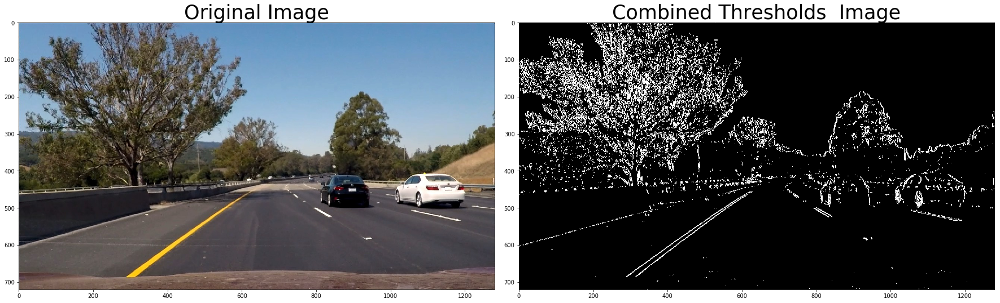

In [9]:
# Check on all the test images
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    
    combined_threshold = combinedGradient_thresholdedBinary(img)
    
    PlotComparisonView(img, combined_threshold, 'Combined Thresholds ', (None, 'gray'))
    
    cv2.imwrite("output_images/write_test"+str(i)+".jpg", combined_threshold)

    

* Let's start playing with color spaces to solve the issues of diffirent colorations of th road we can see for example in the first image.

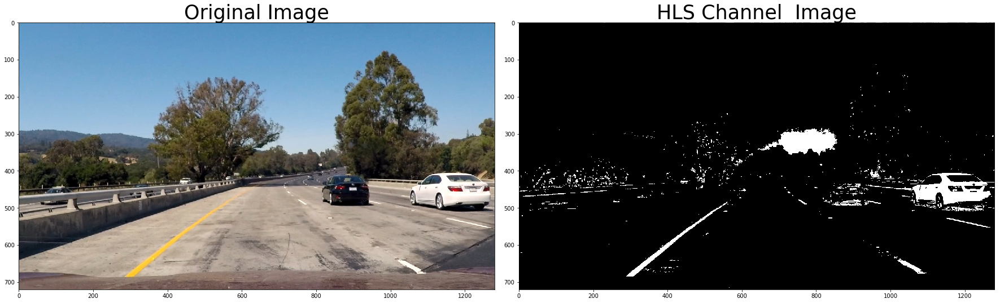

In [10]:
def to_HLS_Color_Channel(img, L_thresh=(200,255), S_thresh=(200,255)):
    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    
    H_thresh = (10,40)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    
    S_binary = np.zeros_like(S)
    L_binary = np.zeros_like(L)
    H_binary = np.zeros_like(H)

#    S_binary[ ( ( L >= L_thresh[0] ) & ( L <= L_thresh[1] ) ) 
#            | ( ( S >= S_thresh[0]) & (S <= S_thresh[1] ) ) ] = 1

    L_binary[ (L >= L_thresh[0]) & (L <= L_thresh[1]) ] = 1 # to extract white lanes
    S_binary[ (S >= S_thresh[0]) & (S <= S_thresh[1]) ] = 1
    H_binary[ (H >= H_thresh[0]) & (H <= H_thresh[1]) ] = 1
    
    return L_binary | S_binary



image = mpimg.imread(test_images[0])
#s_binary = to_S_Color_Channel(image,(190,255))
s_binary = to_HLS_Color_Channel(image)

PlotComparisonView(image, s_binary, 'HLS Channel ', (None, 'gray'))


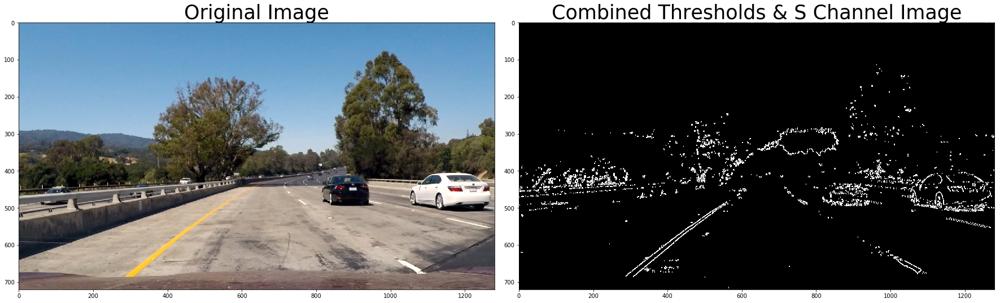

In [11]:
s_binary = to_HLS_Color_Channel(image)

combined_threshold = combinedGradient_thresholdedBinary(s_binary)

PlotComparisonView(image, combined_threshold, 'Combined Thresholds & S Channel', (None, 'gray'))

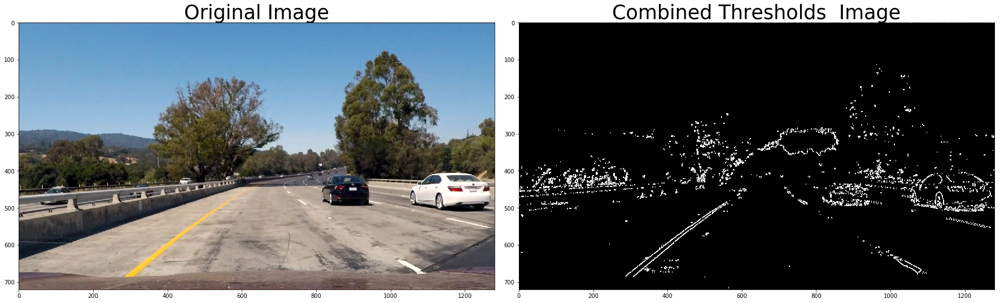

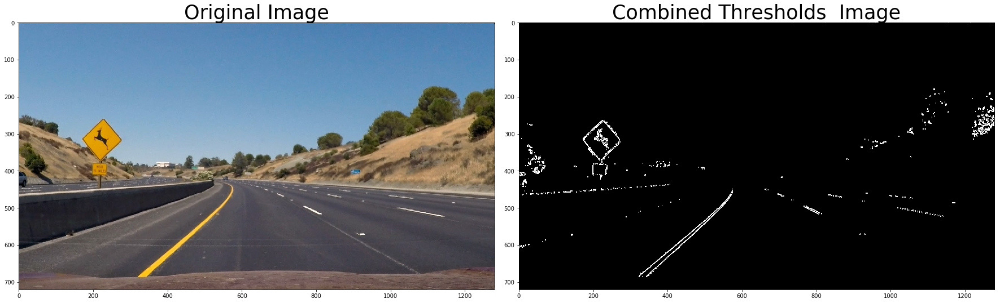

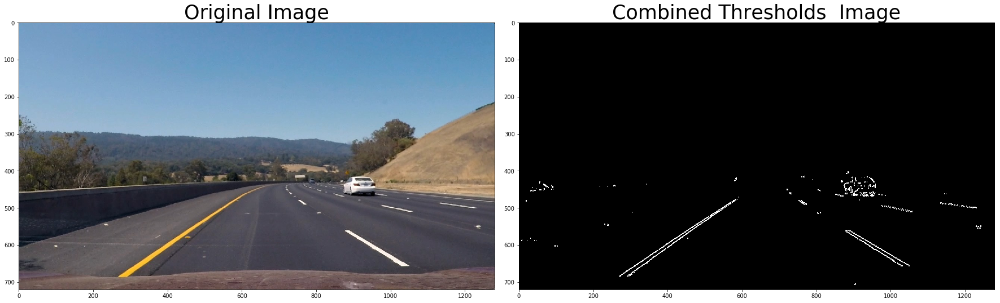

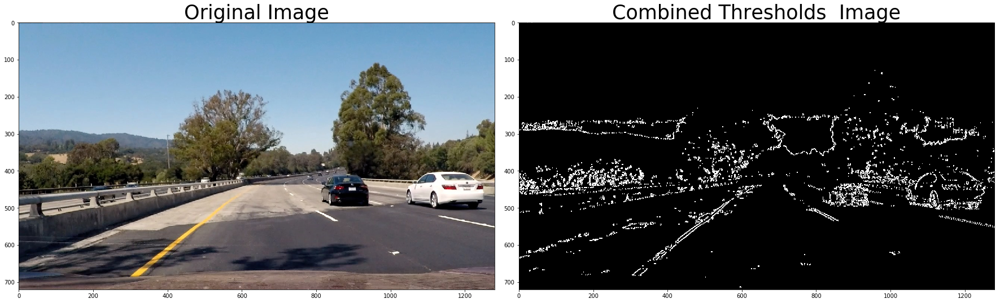

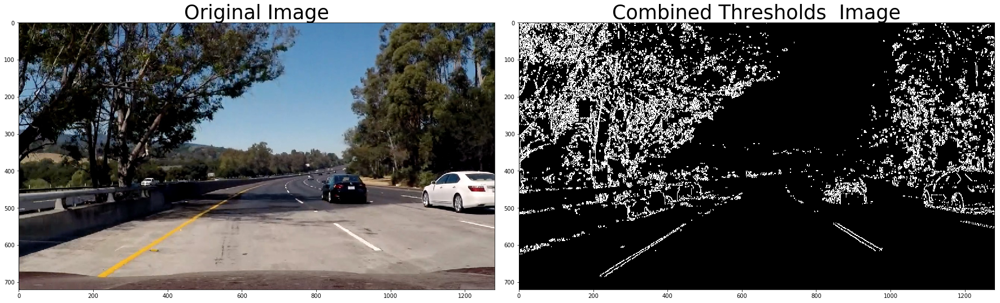

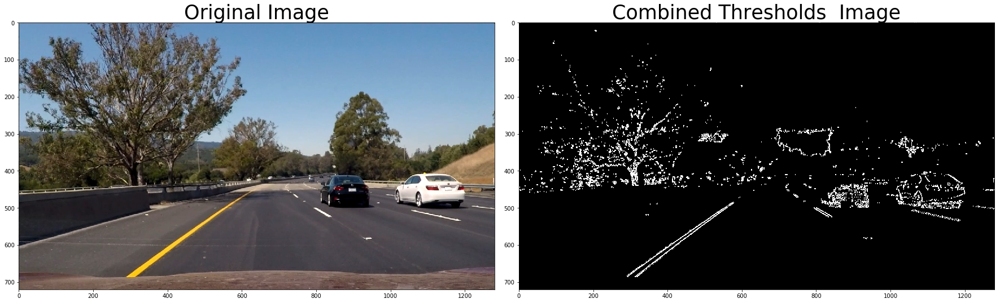

In [12]:
# Check on all the test images
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    
    s_binary = to_HLS_Color_Channel(img)
    
    combined_threshold = combinedGradient_thresholdedBinary(s_binary)
    
    PlotComparisonView(img, combined_threshold, 'Combined Thresholds ', (None, 'gray'))


 ## I'll use now a perspective transform to rectify binary image ("birds-eye view")

In [13]:
def drawConvexPolygonEdgesVertices(img, pts, edge = True, vertex = True):
    """
    pts: a sequence of pts that create a convex polygon
    """
    col = [255, 0, 0]
    thick = 3
    rad = 15
    
    img_copy = img.copy() # avoid img_copy = img as both images will be modified 
    
    if vertex == True:
        # draw vertices
        for pt in pts:
            cv2.circle(img_copy, pt, rad, col, -thick, lineType=8, shift=0)
    
   
    if edge == True:
        # draw edges
        N = len(pts)
        for i in range(N):
            
            cv2.line(img_copy, pts[ i ], pts[ (i+1) % N ], col, thick)
    
    return img_copy



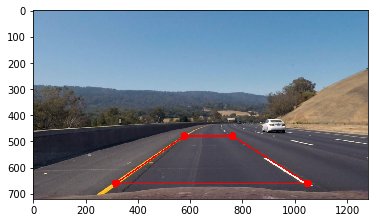

In [14]:
%matplotlib qt
image = mpimg.imread(test_images[2])
image = cal_undistort(image, objpoints, imgpoints)
img_size = ( image.shape[1], image.shape[0] )

# Manually selecting the cordinnates for a src points of RoI
src_p1 = (316,660)  # bottom left
src_p2 = (1050,660) # bottom right
src_p3 = (762,480)  # top right
src_p4 = (578,480)  # top left

src = np.float32([ src_p1, src_p2, src_p3, src_p4 ])

image_RoI = drawConvexPolygonEdgesVertices(image, [ src_p1, src_p2, src_p3, src_p4 ])

plt.imshow(image_RoI)
plt.show()

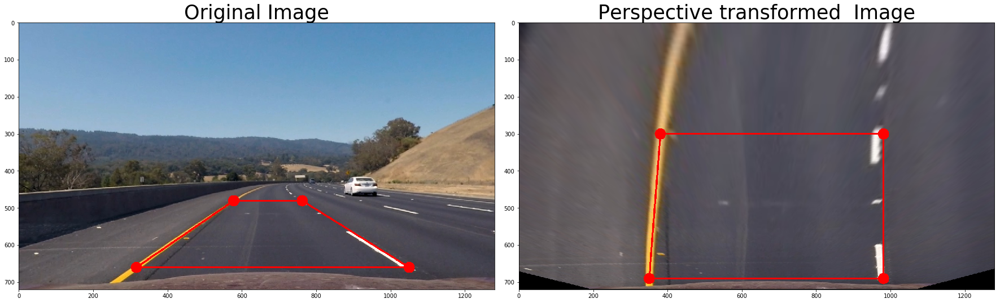

In [15]:
%matplotlib inline

height = image.shape[0]
width = image.shape[1]
# Manually selecting the cordinnates for a dst points of RoI
# need for a more reliable way to select src and dst points
dst_p1 = (350, height - 30)       # bottom left
dst_p2 = (width-300, height - 30) # bottom right
dst_p3 = (width-300, 300)         # top right
dst_p4 = (380, 300)               # top left

dst = np.float32([ dst_p1, dst_p2, dst_p3, dst_p4])

# generate perspective transofrmation matrix given source and destination points
M = cv2.getPerspectiveTransform(src, dst)

# perform perspective transformation
warped = cv2.warpPerspective(image, M, img_size, flags=cv2.INTER_LINEAR)

warped_RoI = drawConvexPolygonEdgesVertices(warped, [ dst_p1, dst_p2, dst_p3, dst_p4])

PlotComparisonView(image_RoI, warped_RoI, 'Perspective transformed ', colormap = (None, None))



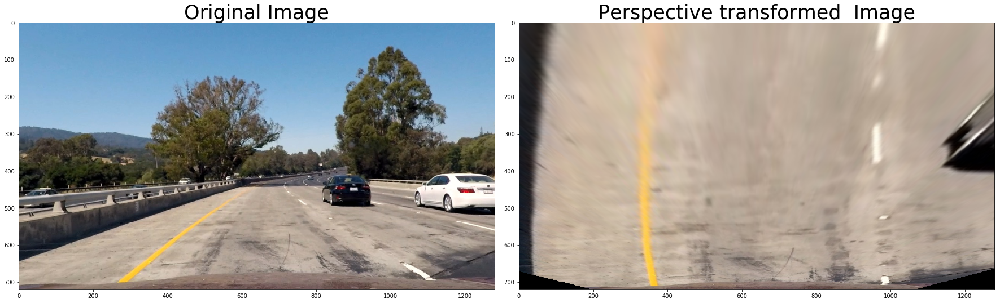

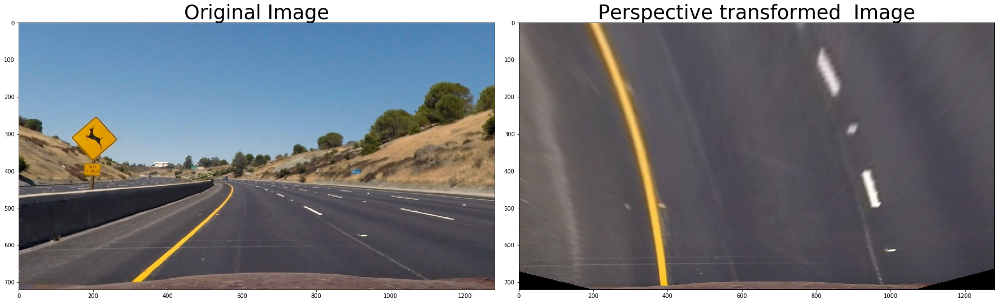

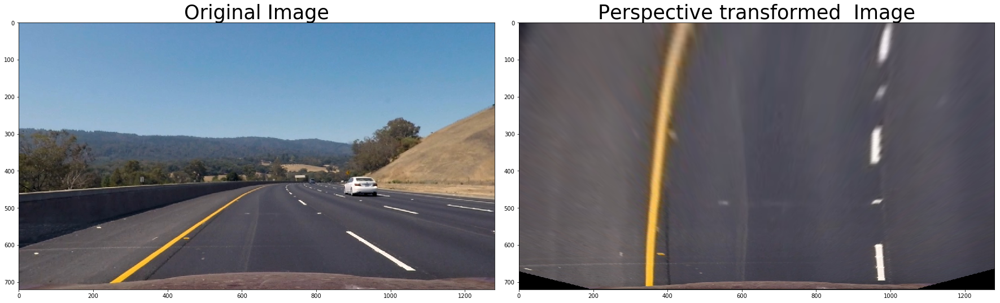

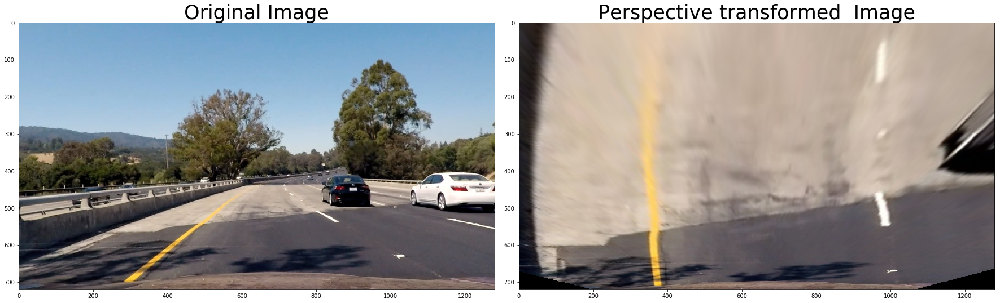

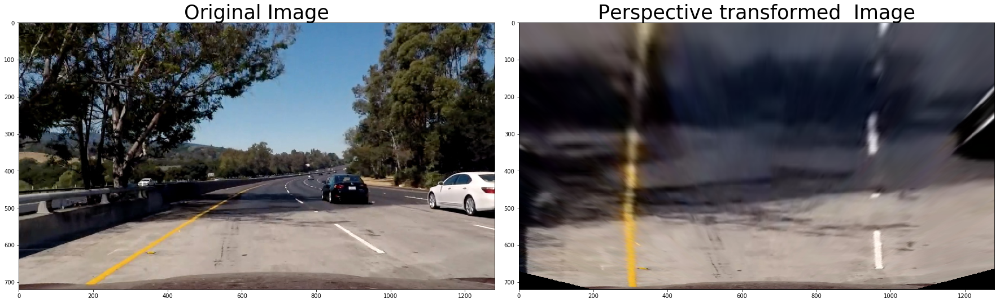

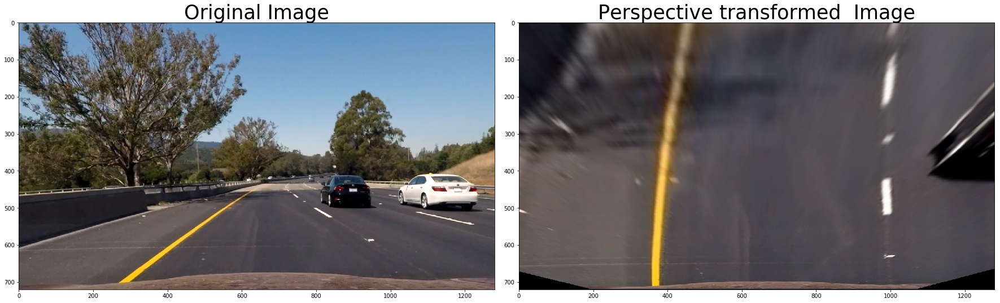

In [16]:
# Check result for all test images
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    undistort_img = cal_undistort(img, objpoints, imgpoints)

    warped_img = cv2.warpPerspective(undistort_img, M, img_size, flags=cv2.INTER_LINEAR)

    PlotComparisonView(undistort_img, warped_img, 'Perspective transformed ', (None, 'gray'))


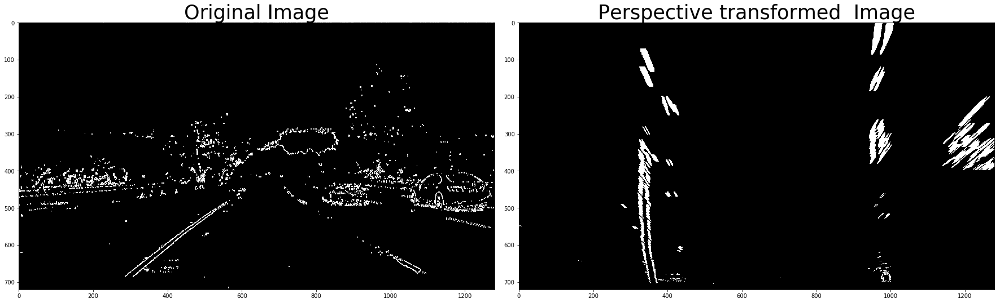

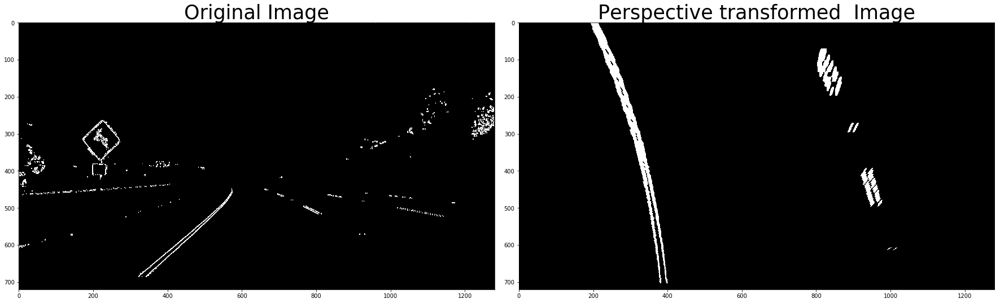

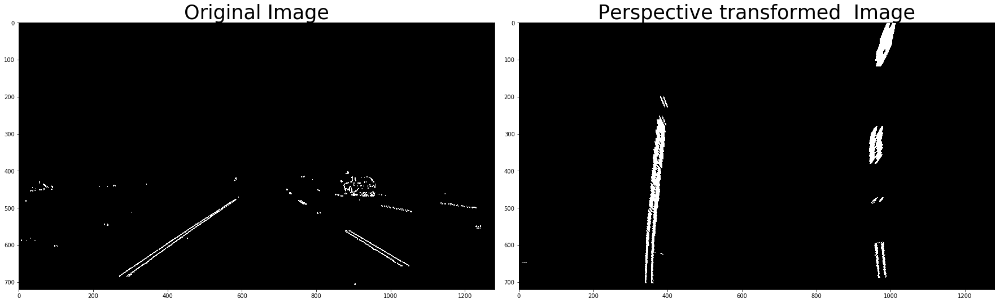

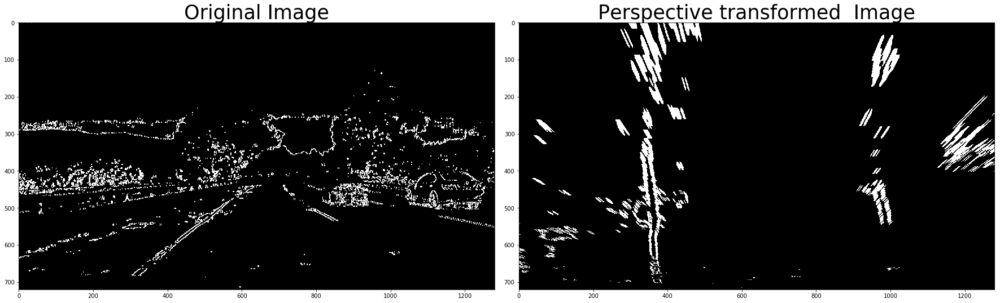

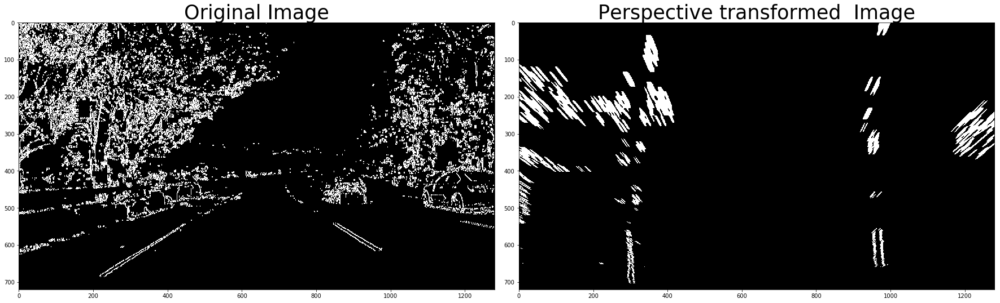

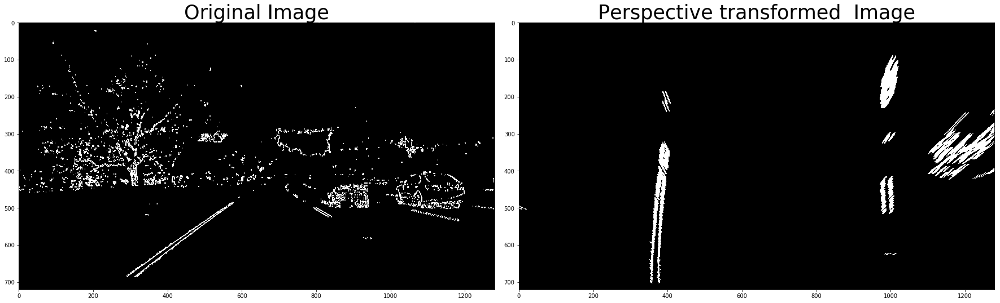

In [17]:
# Check result for all test binary images
test_warped_imgs = []
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    undistort_img = cal_undistort(img, objpoints, imgpoints)

    
    s_binary = to_HLS_Color_Channel(img)
    
    combined_threshold = combinedGradient_thresholdedBinary(s_binary)
    
    warped_img = cv2.warpPerspective(combined_threshold, M, img_size, flags=cv2.INTER_LINEAR)
    test_warped_imgs += [warped_img]

    PlotComparisonView(combined_threshold, warped_img, 'Perspective transformed ', ('gray', 'gray'))


## Detect lane pixels and fit to find the lane boundary.

In [18]:
# reuse histogram from course material
def hist(img):
    # TO-DO: Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car

    height = img.shape[0]
    bottom_half = img[ height//2:,: ]

    # TO-DO: Sum across image pixels vertically - make sure to set `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum( bottom_half, axis=0)
    
    return histogram


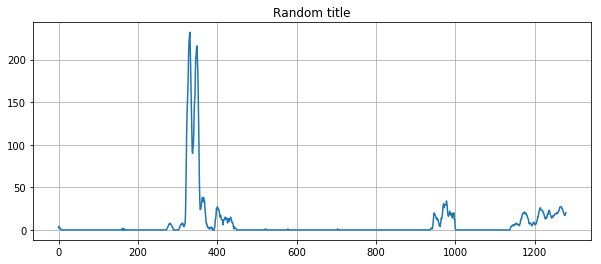

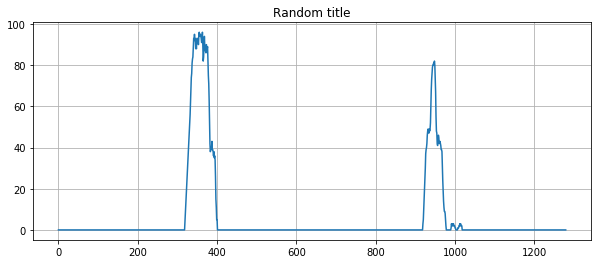

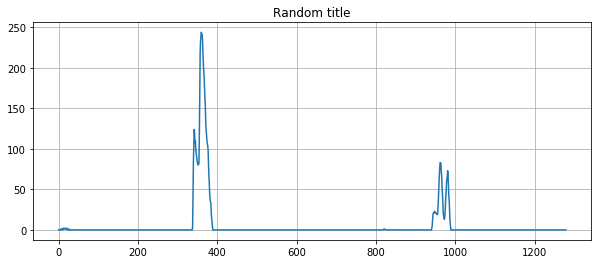

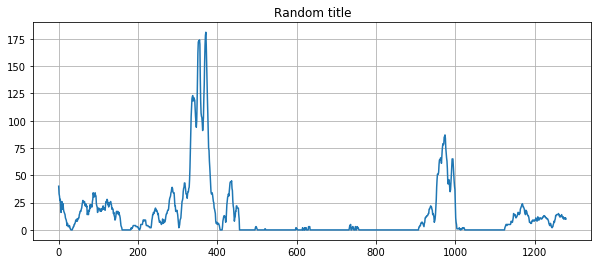

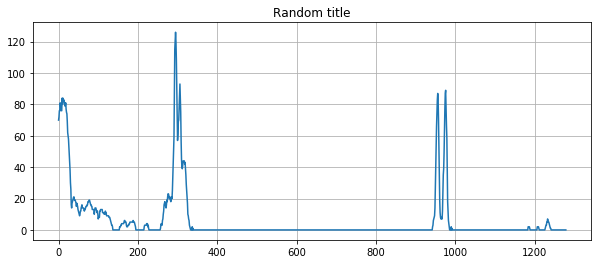

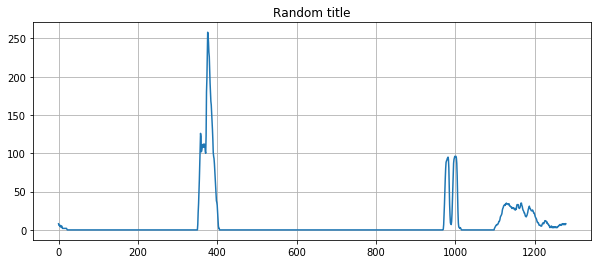

In [19]:
for i in range(6):
    # Create histogram of image binary activations
    histogram = hist(test_warped_imgs[i])

    # Visualize the resulting histogram
    fig = plt.figure(1, figsize=(10, 4))
    plt.title("Random title")
    plt.grid()
    plt.plot(histogram)
    plt.show()

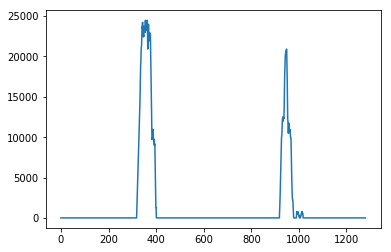

stacked image dimension (720, 1280, 3)
(1280,)
640
355 948
(array([  0,   0,   0, ..., 703, 703, 703], dtype=int64), array([192, 193, 194, ..., 389, 390, 398], dtype=int64))
546 0
new left base is ==> 385
950 45
new left base is ==> 375
1257 254
new left base is ==> 362
new right base is ==> 957
1548 2124
new left base is ==> 347
new right base is ==> 945
1821 86
new left base is ==> 329
new right base is ==> 940
1793 333
new left base is ==> 307
new right base is ==> 898
1869 842
new left base is ==> 281
new right base is ==> 844
1962 2787
new left base is ==> 252
new right base is ==> 828
1829 168
new left base is ==> 219
new right base is ==> 818
Number of non zero pixels are in the whole image (20480,)
Number of non zero pixels indices on the left lane (13575,)
Number of non zero pixels indices on the right lane (6639,)
(720, 1280, 3)


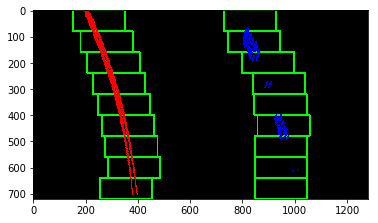

In [20]:
# HYPERPARAMETERS
# Choose the number of sliding windows
nwindows = 9
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50

test_im = test_warped_imgs[1]
if np.max(test_im) == 1:
    test_im = np.uint8(255*test_im)

histogram = hist(test_im)
plt.plot(histogram)
plt.show()

out_img = np.dstack((test_im, test_im, test_im))
print("stacked image dimension", out_img.shape)
# peak of left and right part of the histogram, starting points of left and right lanes
print(histogram.shape)
midpoint = np.int(histogram.shape[0]//2)
print(midpoint)

leftxbase = np.argmax(histogram[:midpoint])
rightxbase = np.argmax(histogram[midpoint:]) + midpoint
print(leftxbase, rightxbase)

# Set height of windows - based on nwindows above and image shape
window_height = np.int(test_im.shape[0]//nwindows)

# Identify the x and y positions of all nonzero pixels in the image
nonzero = test_im.nonzero()
print(nonzero)
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])

# Current positions to be updated later for each window in nwindows
leftx_current = leftxbase
rightx_current = rightxbase

# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = test_im.shape[0] - (window+1)*window_height
    win_y_high = test_im.shape[0] - window*window_height
    ### TO-DO: Find the four below boundaries of the window ###
    win_xleft_low = leftx_current - margin  # Update this
    win_xleft_high = leftx_current + margin  # Update this
    win_xright_low = rightx_current - margin  # Update this
    win_xright_high = rightx_current + margin  # Update this

    #Identify the nonzero pixels in x and y within the window
    left_nonzero_pixels = ( (nonzerox > win_xleft_low) & (nonzerox < win_xleft_high)
                           & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]
    
    right_nonzero_pixels = ( (nonzerox > win_xright_low) & (nonzerox < win_xright_high)
                           & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]
    
    print(len(left_nonzero_pixels), len(right_nonzero_pixels)) # How many non zero pixels indices are on 
                                                               # the left & right line in current window
    left_lane_inds.append(left_nonzero_pixels) 
    right_lane_inds.append(right_nonzero_pixels) 
    
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 5) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 5)
    
    # recalculating the base x-coordinates of left and right windows
    if (len(left_nonzero_pixels) > minpix):
        leftx_pixelpos_current = nonzerox[left_nonzero_pixels]
        leftx_current = np.int(np.mean( leftx_pixelpos_current, axis=0) )
        print("new left base is ==>", leftx_current)
    
    if ( len( right_nonzero_pixels ) > minpix):
        rightx_pixelpos_current = nonzerox[right_nonzero_pixels]
        rightx_current = np.int(np.mean( rightx_pixelpos_current, axis=0) )
        print("new right base is ==>", rightx_current)
    

left_lane_inds = np.concatenate( left_lane_inds )
right_lane_inds = np.concatenate( right_lane_inds )
print("Number of non zero pixels are in the whole image", nonzero[0].shape) #how many non zero pixels are in the whole image
print("Number of non zero pixels indices on the left lane", left_lane_inds.shape) # how many non zero pixels indices are on the left line
print("Number of non zero pixels indices on the right lane", right_lane_inds.shape) # how many non zero pixels indices are on the right line


# get pixel position from pixel indices
leftx_pos = nonzerox[left_lane_inds]
lefty_pos = nonzeroy[left_lane_inds]
rightx_pos = nonzerox[right_lane_inds]
righty_pos = nonzeroy[right_lane_inds]

out_img[ lefty_pos, leftx_pos] = [255, 0, 0]
out_img[ righty_pos, rightx_pos] = [0, 0, 255] 

plt.imshow(out_img)
print(out_img.shape)

In [79]:


def detectLanePixels(test_im, stats=True):
    
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    
    # Make sure image values are in [0, 255] interval
    if np.max(test_im) == 1:
        test_im = np.uint8(255*test_im)
    
    # Create a histogram for the second half of the image
    histogram = hist(test_im)

    # Create output image to draw on and visualize result
    out_img = np.dstack((test_im, test_im, test_im))

    # peak of left and right part of the histogram are starting points of left and right lanes
    midpoint = np.int(histogram.shape[0]//2)
    leftxbase = np.argmax(histogram[:midpoint])
    rightxbase = np.argmax(histogram[midpoint:]) + midpoint


    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(test_im.shape[0]//nwindows)

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = test_im.nonzero() # nonzero is a 2-elements tuple
    nonzeroy = np.array(nonzero[0]) # first element is an array of y coordinates of non-zero pixels
    nonzerox = np.array(nonzero[1]) # second element is an array of x coordinates of non-zero pixels

    # Current positions to be updated later for each window in nwindows
    leftx_current = leftxbase
    rightx_current = rightxbase

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # This list is only for a general stat purpose
    activatedPixels_perWindow = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = test_im.shape[0] - (window+1)*window_height
        win_y_high = test_im.shape[0] - window*window_height

        #Find the four boundaries of the left & right windows on x axis 
        win_xleft_low = leftx_current - margin  
        win_xleft_high = leftx_current + margin 
        win_xright_low = rightx_current - margin  
        win_xright_high = rightx_current + margin

        #Identify the nonzero pixels in x and y within the window
        left_nonzero_pixels = ( (nonzerox > win_xleft_low) & (nonzerox < win_xleft_high)
                               & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]

        right_nonzero_pixels = ( (nonzerox > win_xright_low) & (nonzerox < win_xright_high)
                               & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]

        #print(len(left_nonzero_pixels), len(right_nonzero_pixels)) # How many non zero pixels indices are on 
                                                                   # the left & right line in current window
        activatedPixels_perWindow.insert(0,[len(left_nonzero_pixels), len(right_nonzero_pixels)])    
        
        # add the result to the one from previous windows
        left_lane_inds.append(left_nonzero_pixels) 
        right_lane_inds.append(right_nonzero_pixels) 

        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 5) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 5)

        # recalculating the base x-coordinates of left and right windows
        if (len(left_nonzero_pixels) > minpix):
            # Position of activated pixels in current left window
            leftx_pixelpos_current = nonzerox[left_nonzero_pixels]
            leftx_current = np.int(np.mean( leftx_pixelpos_current, axis=0) )
            #print("new left base is ==>", leftx_current)

        if ( len( right_nonzero_pixels ) > minpix):
            # Position of activated pixels in current right window
            rightx_pixelpos_current = nonzerox[right_nonzero_pixels]
            rightx_current = np.int(np.mean( rightx_pixelpos_current, axis=0) )
            #print("new right base is ==>", rightx_current)

    # reorganise indices across all windows
    left_lane_inds = np.concatenate( left_lane_inds )
    right_lane_inds = np.concatenate( right_lane_inds )
    
    if stats == True:
        print("leftxbase : ", leftxbase, 'rightxbase : ', rightxbase)
        print("Number of non zero pixels are in the whole image", nonzero[0].shape) #how many non zero pixels are in the whole image
        print("Number of non zero pixels indices on the left lane", left_lane_inds.shape) # how many non zero pixels indices are on the left line
        print("Number of non zero pixels indices on the right lane", right_lane_inds.shape) # how many non zero pixels indices are on the right line
        print("Number of activated pixels per window", np.array(activatedPixels_perWindow) )

    # get pixel position from pixel indices
    leftx_pos = nonzerox[left_lane_inds]
    lefty_pos = nonzeroy[left_lane_inds]
    rightx_pos = nonzerox[right_lane_inds]
    righty_pos = nonzeroy[right_lane_inds]

    out_img[ lefty_pos, leftx_pos] = [255, 0, 0]
    out_img[ righty_pos, rightx_pos] = [0, 0, 255]
    
    return leftx_pos, lefty_pos, rightx_pos, righty_pos, out_img



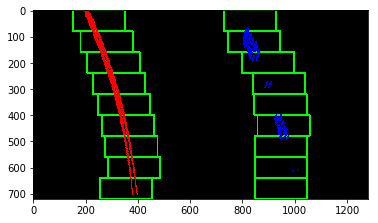

In [22]:
test_img = test_warped_imgs[1]

lane_pixel_img = detectLanePixels(test_img, stats=False)[4]

plt.imshow(lane_pixel_img)
plt.show()

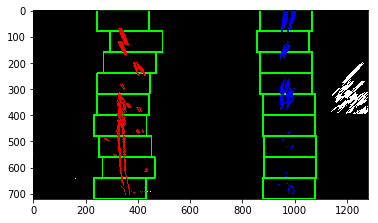

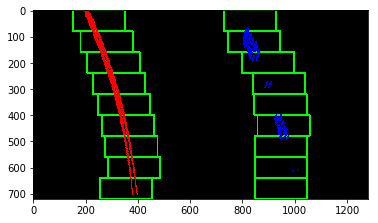

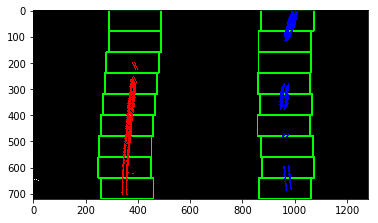

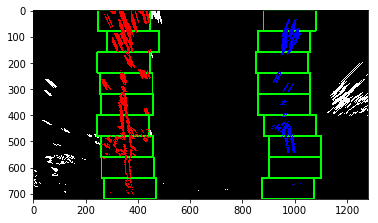

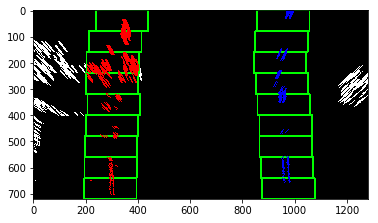

In [23]:
# Apply on all test images
for i in range(5):
    test_img = test_warped_imgs[i]

    lane_pixel_img = detectLanePixels(test_img, stats=False)[4]

    plt.imshow(lane_pixel_img)
    plt.show()

In [72]:
def fit_polynomial_toLane(image, xm_ym_per_pix = (3.7/700, 30/720), plot_poly=True):
    
    # fit a polynomial into the detected pixels so far
    test_img = test_warped_imgs[5]
    leftx, lefty, rightx, righty, lanePixel_im = detectLanePixels(image, stats=False)

    # fitting into a 2nd order polynomial x = f(y)
    #leftfit = np.polyfit( lefty*xm_ym_per_pix[1], leftx*xm_ym_per_pix[0], 2 )
    #rightfit = np.polyfit( righty*xm_ym_per_pix[1], rightx*xm_ym_per_pix[0], 2)

    leftfit = np.polyfit( lefty, leftx, 2 )
    rightfit = np.polyfit( righty, rightx, 2)
    #print("leftfit", leftfit, "rightfit", rightfit)
    # Use the fitting parameters to plot the polynomial on the image
    ## generate y axis base 
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0]).astype(int)
    #ploty = ploty*xm_ym_per_pix[1]
    
    ## compute leftx = f_left(y) & rightx = f_right(y)
    plot_leftx = ( leftfit[0]*ploty**2 + leftfit[1]*ploty + leftfit[2] ).astype(int)
    plot_rightx = ( rightfit[0]*ploty**2 + rightfit[1]*ploty + rightfit[2] ).astype(int)
    
    # plot left and right fitting on lanePixel_im
    #if plot_poly == True:
    #plt.plot( plot_leftx, ploty, color='yellow' )
    #plt.plot( plot_rightx, ploty, color='yellow')
    
    #print(ploty)
    #print(plot_rightx)
    for paint in range(-5,5):
        try:
            lanePixel_im[ ploty, plot_leftx+paint] = [255, 0, 0] # will be painting only a single pixel per y value => not very visible
            lanePixel_im[ ploty, plot_rightx+paint] = [255, 0, 0]
        except:
            break
    #return leftfit, rightfit, lanePixel_im
    return leftfit, rightfit, lanePixel_im

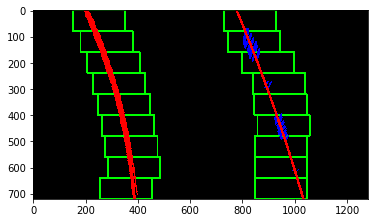

In [80]:
# Run on a single test image
test_img = test_warped_imgs[1]

out_img = fit_polynomial_toLane(test_img)[2]
plt.imshow(out_img)
plt.show()


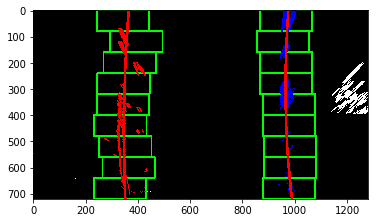

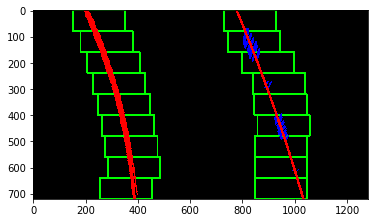

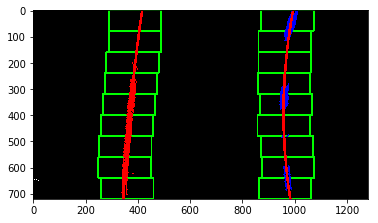

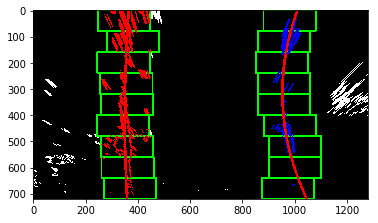

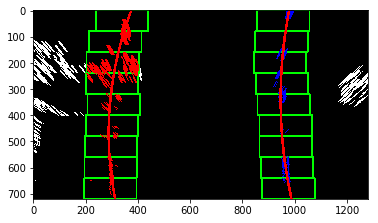

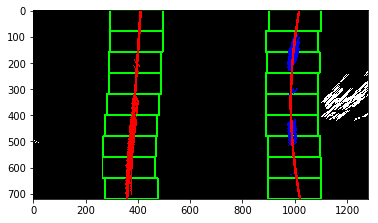

In [81]:
# Let's run on all 6 images
for i in range(6):
    
    current_test_img = test_warped_imgs[i]

    current_out_img = fit_polynomial_toLane(current_test_img)[2]
        
    plt.imshow(current_out_img)
    cv2.imwrite("output_images/polyfit"+str(i)+".jpg", current_out_img)
    plt.show()




#### Once the lane lines are found, skip the sliding window step and perfrom a check around the lane from the last frame

#### Compute curvature of the fitted polynomial

(-1897.2472133559709, -6384.489730800396)


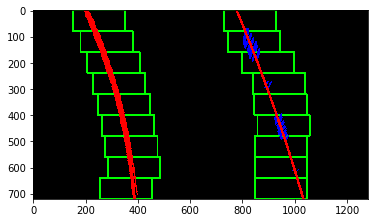

In [82]:
def compute_lane_curvature(test_im):
    
    # introducing the conversion from pixel world to real scale meter world
    xm_per_pix = 3.7/700 # a rigourous reason should be given here?
    ym_per_pix = 30/720
    
    left_fit, right_fit, polyfit_im = fit_polynomial_toLane(test_im, (xm_per_pix,ym_per_pix), plot_poly=True)
    plt.imshow(polyfit_im)

    ploty = np.linspace(0, test_im.shape[0]-1, test_im.shape[0])

    # Select the point where the curvature is calculated
    y_eval = np.max(ploty)

    a_l = left_fit[0]
    b_l = left_fit[1]
    a_r = right_fit[0]
    b_r = right_fit[1]

    # compute left and right curvature using formula from class material
    left_curverad = np.power(1 + (2*a_l*y_eval+b_l)**2, 3/2)/(2*a_l)  
    right_curverad = np.power(1 + (2*a_r*y_eval+b_r)**2, 3/2)/(2*a_r) 

    #print("left_lane_curvature", left_curverad, "right_lane_curvature", right_curverad)
    return left_curverad, right_curverad


test_img = test_warped_imgs[1]
print( compute_lane_curvature( test_img ) )

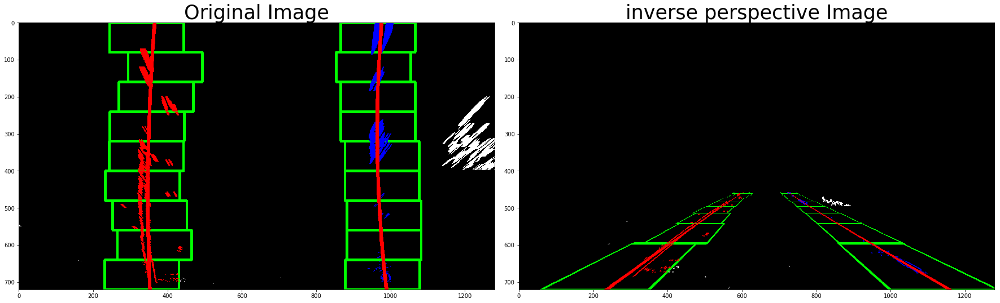

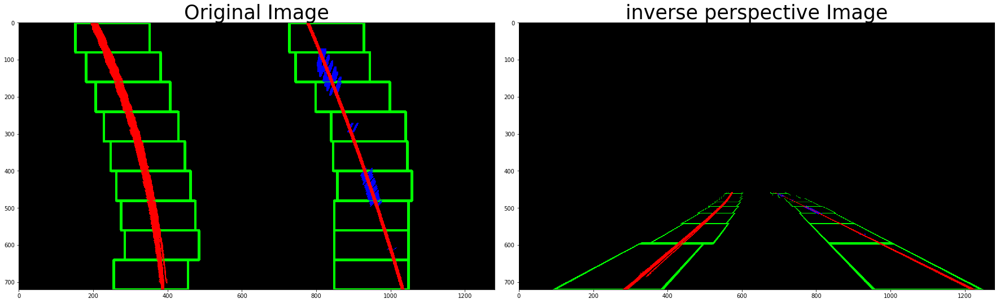

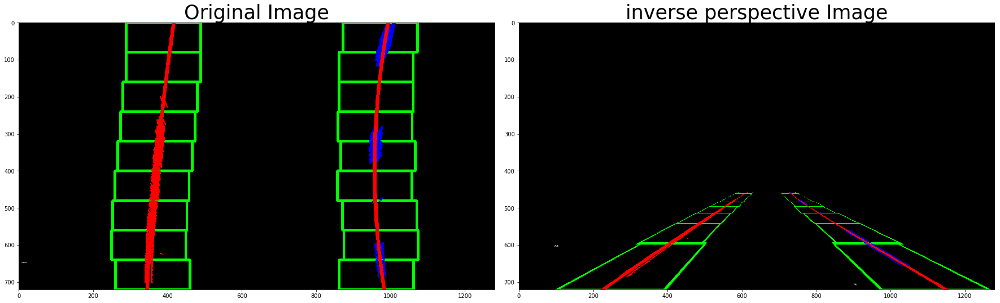

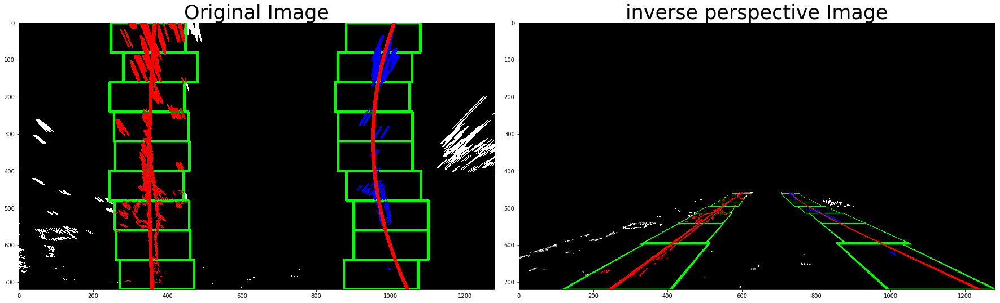

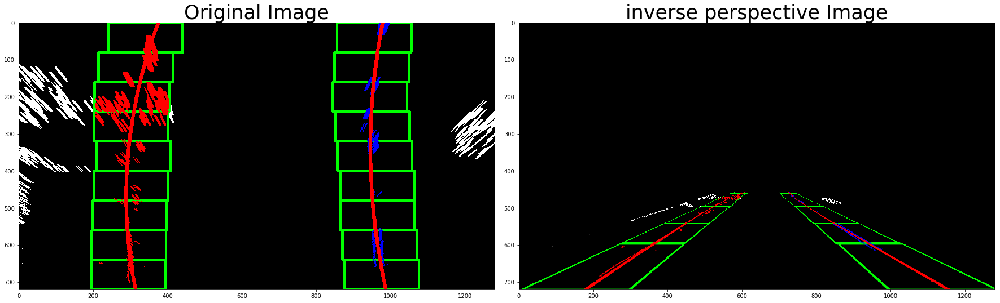

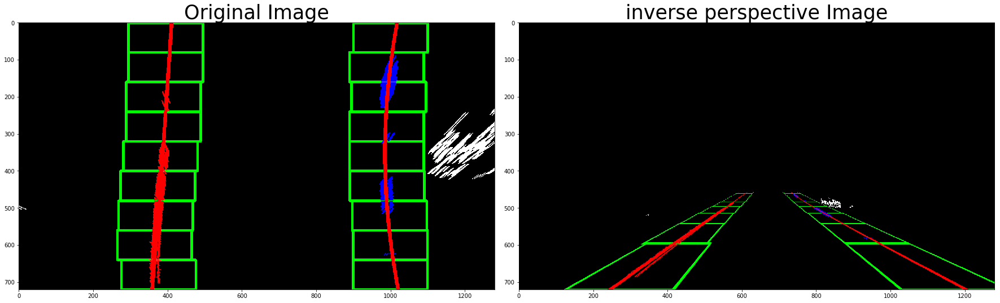

In [83]:
# perspective transform inverse

# generate perspective transofrmation matrix given source and destination points
Minv = cv2.getPerspectiveTransform(dst, src)

warped_imgs = [] # inversed perspective images

for i in range (6):
    test_img = test_warped_imgs[i]
    lane_pixel_img = fit_polynomial_toLane(test_img)[2]

    # perform perspective transformation
    warped = cv2.warpPerspective(lane_pixel_img, Minv, img_size, flags=cv2.INTER_LINEAR)
    warped_imgs += [warped]
    
    PlotComparisonView(lane_pixel_img, warped, 'inverse perspective', colormap = (None, None))

    #plt.imshow(warped)
    #plt.show()

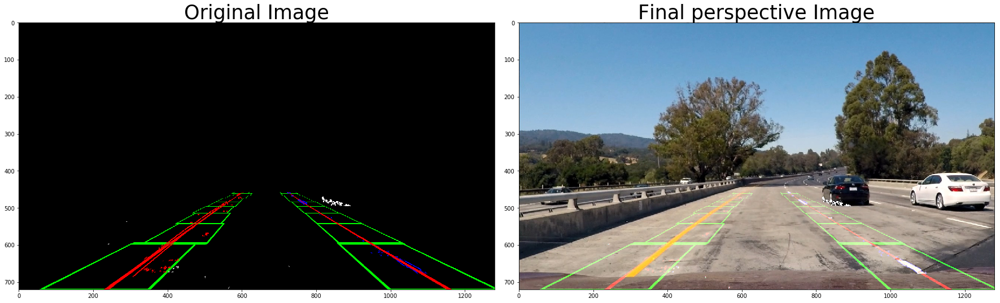

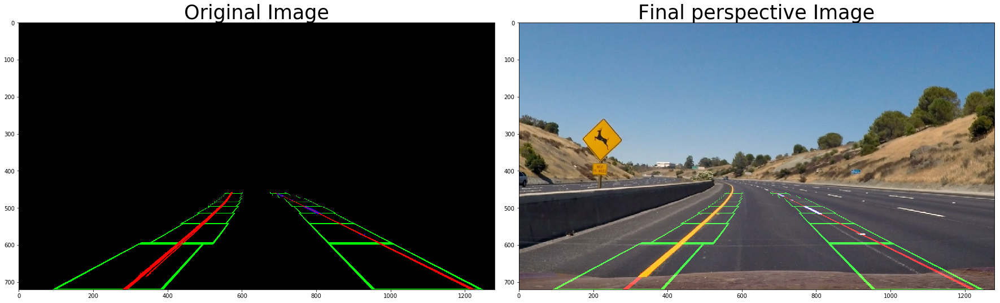

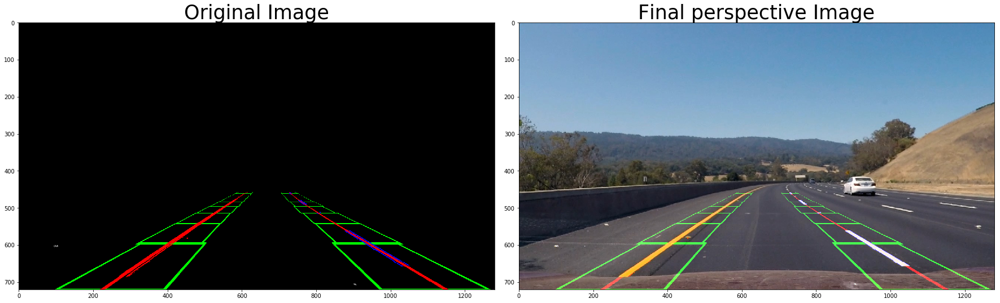

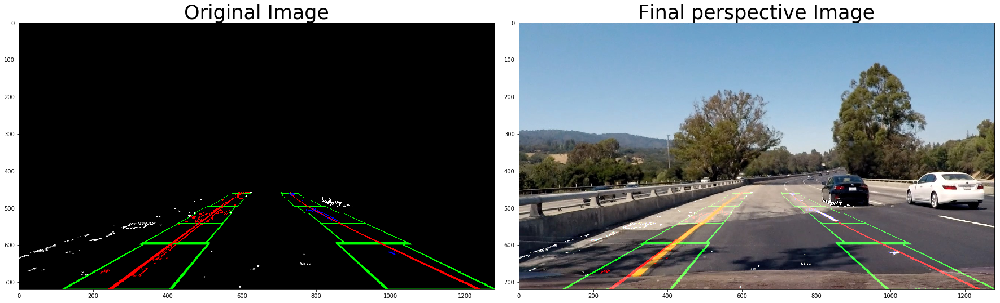

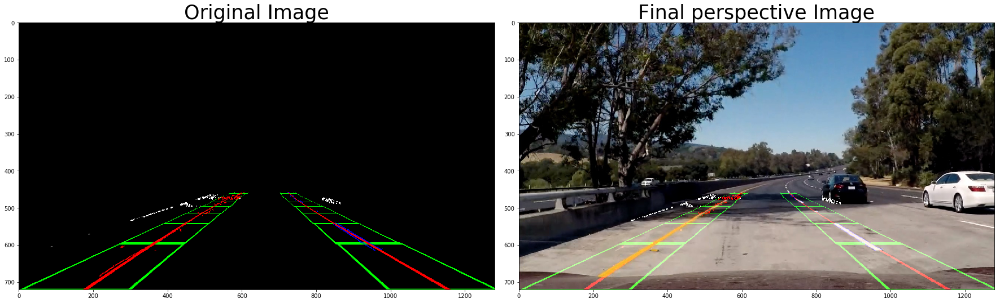

In [29]:
combined_imgs = []

for i in range(5):
    
    warped = warped_imgs[i]

    img = mpimg.imread(test_images[i])

    combined_img = warped | img
    combined_imgs += [combined_img]

    PlotComparisonView(warped, combined_img, 'Final perspective', colormap = (None, None))
    cv2.imwrite("output_images/finalPerspective"+str(i)+".jpg", cv2.cvtColor(combined_img, cv2.COLOR_RGB2BGR))


In [49]:
def advancedLaneFindingPipeline(input_img):
    
    # undistort input image
    undistort_img = cal_undistort(input_img, objpoints, imgpoints)

    # create a binary from HLS color space
    hls_binary = to_HLS_Color_Channel(undistort_img)
    
    # create a binary using axis, magnitude and direction gradient on hls_binary
    combined_threshold = combinedGradient_thresholdedBinary(hls_binary)
    
    # perform perspective transform to bird-eye view
    warped_img = cv2.warpPerspective(combined_threshold, M, img_size, flags=cv2.INTER_LINEAR)
    
    # detect lane pixel on bird-eye view image and generate fitting polynomial
    lane_pixel_img = fit_polynomial_toLane(warped_img)[2]
    current_fit = fit_polynomial_toLane(warped_img)[:2]
    print(current_fit)

    # perform inverse perspective transformation from bird-eye view
    unwarped_img = cv2.warpPerspective(lane_pixel_img, Minv, img_size, flags=cv2.INTER_LINEAR)
    
    # draw result on input_img
    finalresult_img = unwarped_img | input_img
    #PlotComparisonView(unwarped_img, finalresult_img, 'Final perspective', colormap = (None, None))
    
    # save result into output_images folder
    #cv2.imwrite("output_images/finalPerspective"+str(i)+".jpg", cv2.cvtColor(combined_img, cv2.COLOR_RGB2BGR))
    
    return finalresult_img


(array([ 7.72495807e-05, -1.59138259e-01,  4.21811177e+02]), array([ 2.74831663e-04, -2.32830374e-01,  1.00628807e+03]))


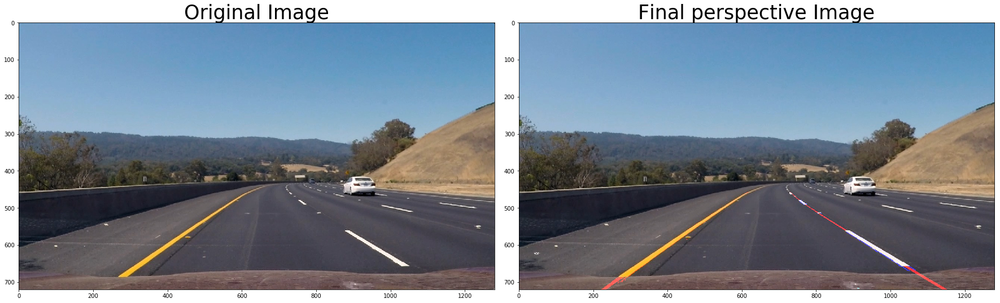

In [44]:
# test full pipeline on a single image
my_img = mpimg.imread(test_images[2])

final = advancedLaneFindingPipeline(my_img)
PlotComparisonView(my_img, final, 'Final perspective', colormap = (None, None))

In [32]:
for i in range(6):
    
    my_img = mpimg.imread(test_images[i])
    final = advancedLaneFindingPipeline(my_img)

## First, Let's try this pipeline on  the initial video stream as naive "independant" images

In [104]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [105]:
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    result = advancedLaneFindingPipeline(image)
    # you should return the final output (image where lines are drawn on lanes)

    return result

In [108]:
video_output = 'output_videos/project_video_solution7.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
clip1 = VideoFileClip("project_video.mp4").subclip(0, 0.4)
print(type(clip1))
#clip1 = VideoFileClip("project_video.mp4")

white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(video_output, audio=False)

OSError: [WinError 6] The handle is invalid

In [39]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

### Let's skip the sliding windows step once I've found the lines
* In brief the guidline is : Once you know where the lines are in one frame of video, you can do a highly targeted search for them in the next frame.

In [111]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]
        #polynomial coefficients for the most recent fits
        self.recent_fits = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None  

        
# Create two instances from this class
left_line = Line()
right_line = Line()

In [109]:
# Turns out most the change will be in detectLanePixels function and in the way left_lane_inds & right_lane_inds are calculated

def detectLanePixels(test_im, last_fit, stats=True):
    """
    This function returns the positions of activated pixels in left and right lanes
    and the output image with those pixels painted
    """
    
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    
    # Make sure image values are in [0, 255] interval
    if np.max(test_im) == 1:
        test_im = np.uint8(255*test_im)
    
    # Create a histogram for the second half of the image
    histogram = hist(test_im)

    # Create output image to draw on and visualize result
    out_img = np.dstack((test_im, test_im, test_im))

    # peak of left and right part of the histogram are starting points of left and right lanes
    midpoint = np.int(histogram.shape[0]//2)
    leftxbase = np.argmax(histogram[:midpoint])
    rightxbase = np.argmax(histogram[midpoint:]) + midpoint

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = test_im.nonzero() # nonzero is a 2-elements tuple
    nonzeroy = np.array(nonzero[0]) # first element is an array of y coordinates of non-zero pixels
    nonzerox = np.array(nonzero[1]) # second element is an array of x coordinates of non-zero pixels

    # Current positions to be updated later for each window in nwindows
    leftx_current = leftxbase
    rightx_current = rightxbase
    
    
    if last_fit == False: # use sliding windows approach
        
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # This list is only for a general stat purpose
        activatedPixels_perWindow = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = test_im.shape[0] - (window+1)*window_height
            win_y_high = test_im.shape[0] - window*window_height

            #Find the four boundaries of the left & right windows on x axis 
            win_xleft_low = leftx_current - margin  
            win_xleft_high = leftx_current + margin 
            win_xright_low = rightx_current - margin  
            win_xright_high = rightx_current + margin

            #Identify the nonzero pixels in x and y within the window
            left_nonzero_pixels = ( (nonzerox > win_xleft_low) & (nonzerox < win_xleft_high)
                                   & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]

            right_nonzero_pixels = ( (nonzerox > win_xright_low) & (nonzerox < win_xright_high)
                                   & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]

            #print(len(left_nonzero_pixels), len(right_nonzero_pixels)) # How many non zero pixels indices are on 
                                                                       # the left & right line in current window
            activatedPixels_perWindow.insert(0,[len(left_nonzero_pixels), len(right_nonzero_pixels)])    

            # add the result to the one from previous windows
            left_lane_inds.append(left_nonzero_pixels) 
            right_lane_inds.append(right_nonzero_pixels) 

            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 5) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 5)

            # recalculating the base x-coordinates of left and right windows
            if (len(left_nonzero_pixels) > minpix):
                # Position of activated pixels in current left window
                leftx_pixelpos_current = nonzerox[left_nonzero_pixels]
                leftx_current = np.int(np.mean( leftx_pixelpos_current, axis=0) )
                #print("new left base is ==>", leftx_current)

            if ( len( right_nonzero_pixels ) > minpix):
                # Position of activated pixels in current right window
                rightx_pixelpos_current = nonzerox[right_nonzero_pixels]
                rightx_current = np.int(np.mean( rightx_pixelpos_current, axis=0) )
                #print("new right base is ==>", rightx_current)

        # reorganise indices across all windows
        left_lane_inds = np.concatenate( left_lane_inds )
        right_lane_inds = np.concatenate( right_lane_inds )
        
    
    elif last_fit == True: # Use info from previous frames
        
        margin = 100
        
        # Get left_fit and right_fit of last frame lines instances
        last_left_fit = left_line.best_fit
        last_right_fit = right_line.best_fit

        # Create  lists to receive left and right lane pixel indices by exploring the region next to where
        # last lanes polyfit were found
        left_lane_inds = ( (nonzerox > (last_left_fit[0]*(nonzeroy**2) + last_left_fit[1]*nonzeroy + 
                        last_left_fit[2] - margin) ) & (nonzerox < (last_left_fit[0]*(nonzeroy**2) + 
                        last_left_fit[1]*nonzeroy + last_left_fit[2] + margin)))

        right_lane_inds = ((nonzerox > (last_right_fit[0]*(nonzeroy**2) + last_right_fit[1]*nonzeroy + 
                        last_right_fit[2] - margin)) & (nonzerox < (last_right_fit[0]*(nonzeroy**2) + 
                        last_right_fit[1]*nonzeroy + last_right_fit[2] + margin)))


    

    # get pixel position from pixel indices
    leftx_pos = nonzerox[left_lane_inds]
    lefty_pos = nonzeroy[left_lane_inds]
    rightx_pos = nonzerox[right_lane_inds]
    righty_pos = nonzeroy[right_lane_inds]

    out_img[ lefty_pos, leftx_pos] = [255, 0, 0]
    out_img[ righty_pos, rightx_pos] = [0, 0, 255]
    
    if stats == True:
        print("leftxbase : ", leftxbase, 'rightxbase : ', rightxbase)
        print("Number of non zero pixels are in the whole image", nonzero[0].shape) #how many non zero pixels are in the whole image
        print("Number of non zero pixels indices on the left lane", left_lane_inds.shape) # how many non zero pixels indices are on the left line
        print("Number of non zero pixels indices on the right lane", right_lane_inds.shape) # how many non zero pixels indices are on the right line
        print("Number of activated pixels per window", np.array(activatedPixels_perWindow) )

    return leftx_pos, lefty_pos, rightx_pos, righty_pos, out_img


In [113]:
def fit_polynomial_toLane(image, last_fit, xm_ym_per_pix = (3.7/700, 30/720), plot_poly=True):
    
    # fit a polynomial into the detected pixels so far
    test_img = test_warped_imgs[5]
    leftx, lefty, rightx, righty, lanePixel_im = detectLanePixels(image, last_fit, stats=False)

    # fitting into a 2nd order polynomial x = f(y)
    #leftfit = np.polyfit( lefty*xm_ym_per_pix[1], leftx*xm_ym_per_pix[0], 2 )
    #rightfit = np.polyfit( righty*xm_ym_per_pix[1], rightx*xm_ym_per_pix[0], 2)

    leftfit = np.polyfit( lefty, leftx, 2 )
    rightfit = np.polyfit( righty, rightx, 2)
    print("leftfit", leftfit, "rightfit", rightfit)
    # Use the fitting parameters to plot the polynomial on the image
    ## generate y axis base 
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0]).astype(int)
    #ploty = ploty*xm_ym_per_pix[1]
    
    ## compute leftx = f_left(y) & rightx = f_right(y)
    plot_leftx = ( leftfit[0]*ploty**2 + leftfit[1]*ploty + leftfit[2] ).astype(int)
    plot_rightx = ( rightfit[0]*ploty**2 + rightfit[1]*ploty + rightfit[2] ).astype(int)
    
    # plot left and right fitting on lanePixel_im
    #if plot_poly == True:
    #plt.plot( plot_leftx, ploty, color='yellow' )
    #plt.plot( plot_rightx, ploty, color='yellow')
    
    #print(ploty)
    #print(plot_rightx)
    for paint in range(-5,5):
        try:
            lanePixel_im[ ploty, plot_leftx+paint] = [255, 0, 0] # will be painting only a single pixel per y value => not very visible
            lanePixel_im[ ploty, plot_rightx+paint] = [255, 0, 0]
        except:
            break
            
    return leftfit, rightfit, lanePixel_im

In [114]:
def advancedLaneFindingPipeline(input_img, last_fit):
    
    # undistort input image
    undistort_img = cal_undistort(input_img, objpoints, imgpoints)

    # create a binary from HLS color space
    hls_binary = to_HLS_Color_Channel(undistort_img)
    
    # create a binary using axis, magnitude and direction gradient on hls_binary
    combined_threshold = combinedGradient_thresholdedBinary(hls_binary)
    
    # perform perspective transform to bird-eye view
    warped_img = cv2.warpPerspective(combined_threshold, M, img_size, flags=cv2.INTER_LINEAR)
    
    # detect lane pixel on bird-eye view image and generate fitting polynomial
    #if left_line.detected == True and right_line.detected == True:
        
    current_left_fit, current_right_fit, lane_pixel_img = fit_polynomial_toLane(warped_img, last_fit=False, plot_poly=False)
    
    # storing the recent fits of the polymomial
    left_line.recent_fits.append( current_left_fit )
    right_line.recent_fits.append( current_right_fit )

    current_fit = [current_left_fit, current_right_fit]
    print(current_fit)

    # perform inverse perspective transformation from bird-eye view
    unwarped_img = cv2.warpPerspective(lane_pixel_img, Minv, img_size, flags=cv2.INTER_LINEAR)
    
    # draw result on input_img
    finalresult_img = unwarped_img | input_img
    #PlotComparisonView(unwarped_img, finalresult_img, 'Final perspective', colormap = (None, None))
    
    # save result into output_images folder
    #cv2.imwrite("output_images/finalPerspective"+str(i)+".jpg", cv2.cvtColor(combined_img, cv2.COLOR_RGB2BGR))
    
    return finalresult_img


In [112]:
# Let's play a bit more with the way I am handling video files
video_output = 'output_videos/project_video_solution7.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
clipLength = 0.4
clip1 = VideoFileClip("project_video.mp4").subclip(0, clipLength)
print(type(clip1))

f = clip1.get_frame(0.1)
# number of frames in clip iterator
N = sum( 1 for f in clip1.iter_frames() )
print("N =>", N)



#clip1 = VideoFileClip("project_video.mp4")

#white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!


OSError: [WinError 6] The handle is invalid